Requirement

In [3]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import os
import matplotlib.pyplot as plt
import numpy as np
from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim

Image loader

In [4]:
from PIL import Image, UnidentifiedImageError

class ImageRestorationDataset(torch.utils.data.Dataset):
    def __init__(self, distorted_dir, clear_dir, transform=None):
        self.distorted_dir = distorted_dir
        self.clear_dir = clear_dir
        self.transform = transform

        # Load only .jpg/.png/etc. and filter out anything that cannot be opened
        self.image_names = []
        for fname in os.listdir(distorted_dir):
            if fname.lower().endswith(('.jpg', '.jpeg', '.png')):
                try:
                    # Try to open the file to make sure it's valid
                    img_path = os.path.join(distorted_dir, fname)
                    Image.open(img_path).verify()  # Will throw if corrupt
                    self.image_names.append(fname)
                except Exception as e:
                    print(f"Skipping corrupted or invalid file: {fname} ({e})")

    def __len__(self):
        return len(self.image_names)

    def __getitem__(self, idx):
        distorted_path = os.path.join(self.distorted_dir, self.image_names[idx])
        clear_path = os.path.join(self.clear_dir, self.image_names[idx])

        distorted_img = Image.open(distorted_path).convert("RGB")
        clear_img = Image.open(clear_path).convert("RGB")

        if self.transform:
            distorted_img = self.transform(distorted_img)
            clear_img = self.transform(clear_img)

        return distorted_img, clear_img


U-NET Layer

In [5]:
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()

        def conv_block(in_channels, out_channels):
            return nn.Sequential(
                nn.Conv2d(in_channels, out_channels, 3, padding=1),
                nn.BatchNorm2d(out_channels),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_channels, out_channels, 3, padding=1),
                nn.BatchNorm2d(out_channels),
                nn.ReLU(inplace=True)
            )

        def up_block(in_channels, out_channels):
            return nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)

        self.enc1 = conv_block(3, 64)
        self.pool1 = nn.MaxPool2d(2)
        self.enc2 = conv_block(64, 128)
        self.pool2 = nn.MaxPool2d(2)
        self.enc3 = conv_block(128, 256)
        self.pool3 = nn.MaxPool2d(2)
        self.enc4 = conv_block(256, 512)
        self.pool4 = nn.MaxPool2d(2)

        self.bottleneck = conv_block(512, 1024)

        self.up4 = up_block(1024, 512)
        self.dec4 = conv_block(1024, 512)
        self.up3 = up_block(512, 256)
        self.dec3 = conv_block(512, 256)
        self.up2 = up_block(256, 128)
        self.dec2 = conv_block(256, 128)
        self.up1 = up_block(128, 64)
        self.dec1 = conv_block(128, 64)

        self.final = nn.Conv2d(64, 3, kernel_size=1)

    def forward(self, x):
        e1 = self.enc1(x)
        e2 = self.enc2(self.pool1(e1))
        e3 = self.enc3(self.pool2(e2))
        e4 = self.enc4(self.pool3(e3))

        b = self.bottleneck(self.pool4(e4))

        d4 = self.up4(b)
        d4 = self.dec4(torch.cat([d4, e4], dim=1))
        d3 = self.up3(d4)
        d3 = self.dec3(torch.cat([d3, e3], dim=1))
        d2 = self.up2(d3)
        d2 = self.dec2(torch.cat([d2, e2], dim=1))
        d1 = self.up1(d2)
        d1 = self.dec1(torch.cat([d1, e1], dim=1))

        return torch.sigmoid(self.final(d1))

Caluculation of the avg_psnr,avg_ssim

In [6]:
def evaluate(model, dataloader, device):
    model.eval()
    psnr_total, ssim_total = 0, 0
    with torch.no_grad():
        for distorted, clear in dataloader:
            distorted, clear = distorted.to(device), clear.to(device)
            output = model(distorted)

            for i in range(distorted.size(0)):
                output_np = output[i].cpu().permute(1, 2, 0).numpy()
                clear_np = clear[i].cpu().permute(1, 2, 0).numpy()

                psnr_total += psnr(clear_np, output_np, data_range=1.0)
                ssim_total += ssim(clear_np, output_np, channel_axis=2, data_range=1.0)

    avg_psnr = psnr_total / len(dataloader.dataset)
    avg_ssim = ssim_total / len(dataloader.dataset)
    return avg_psnr, avg_ssim



Intermidiate outputs of images during epoch

In [7]:
def visualize_sample(model, dataloader, device):
    model.eval()
    distorted, clear = next(iter(dataloader))
    distorted, clear = distorted.to(device), clear.to(device)
    output = model(distorted)

    for i in range(3):
        fig, axs = plt.subplots(1, 3, figsize=(12, 4))
        axs[0].imshow(distorted[i].cpu().permute(1, 2, 0).numpy())
        axs[0].set_title("Distorted")
        axs[1].imshow(output[i].detach().cpu().permute(1, 2, 0).numpy())
        axs[1].set_title("Restored")
        axs[2].imshow(clear[i].cpu().permute(1, 2, 0).numpy())
        axs[2].set_title("Ground Truth")
        for ax in axs:
            ax.axis("off")
        plt.show()

Validation loss and training loss 

In [8]:
def train(model, dataloader, optimizer, criterion, device):
    model.train()
    running_loss = 0.0
    for inputs, targets in dataloader:
        inputs, targets = inputs.to(device), targets.to(device)
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    return running_loss / len(dataloader)


def validate_epoch(model, dataloader, criterion, device):
    model.eval()
    running_loss = 0.0
    with torch.no_grad():
        for inputs, targets in dataloader:
            inputs, targets = inputs.to(device), targets.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            running_loss += loss.item()
    return running_loss / len(dataloader)

Final code

Main Function

Using device: cuda
Epoch 1, Loss: 0.0458, Validation Loss: 0.0342
Validation PSNR: 27.05, SSIM: 0.8898,
✅ Best model updated at epoch 1 with PSNR: 27.05
Epoch 2, Loss: 0.0350, Validation Loss: 0.0269
Validation PSNR: 28.77, SSIM: 0.9038,
✅ Best model updated at epoch 2 with PSNR: 28.77
Epoch 3, Loss: 0.0321, Validation Loss: 0.0249
Validation PSNR: 29.31, SSIM: 0.9063,
✅ Best model updated at epoch 3 with PSNR: 29.31
Epoch 4, Loss: 0.0303, Validation Loss: 0.0245
Validation PSNR: 29.43, SSIM: 0.9120,
✅ Best model updated at epoch 4 with PSNR: 29.43
Epoch 5, Loss: 0.0290, Validation Loss: 0.0271
Validation PSNR: 28.94, SSIM: 0.9120,


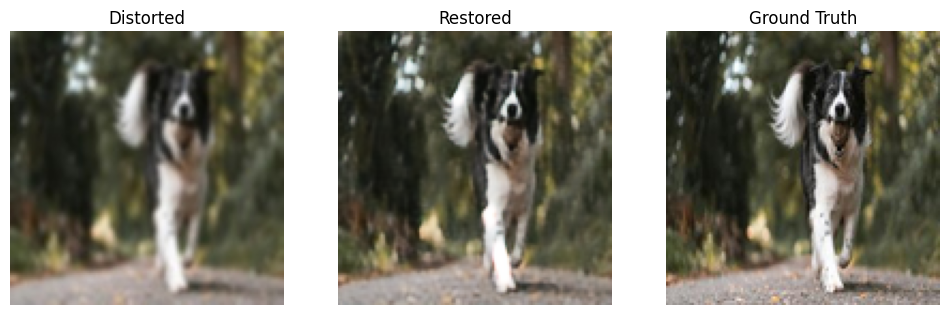

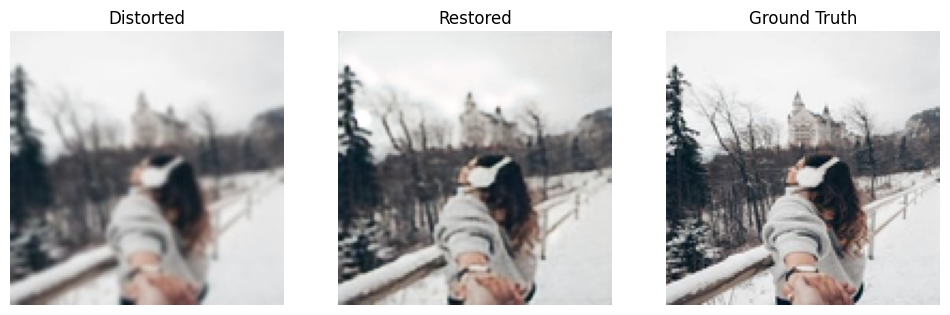

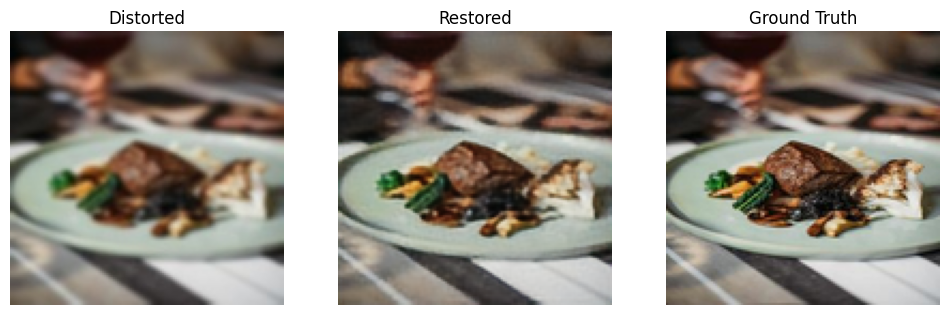

Epoch 6, Loss: 0.0281, Validation Loss: 0.0228
Validation PSNR: 29.82, SSIM: 0.9147,
✅ Best model updated at epoch 6 with PSNR: 29.82
Epoch 7, Loss: 0.0273, Validation Loss: 0.0225
Validation PSNR: 29.93, SSIM: 0.9139,
✅ Best model updated at epoch 7 with PSNR: 29.93
Epoch 8, Loss: 0.0271, Validation Loss: 0.0258
Validation PSNR: 29.26, SSIM: 0.9126,
Epoch 9, Loss: 0.0263, Validation Loss: 0.0325
Validation PSNR: 27.89, SSIM: 0.9151,
Epoch 10, Loss: 0.0262, Validation Loss: 0.0281
Validation PSNR: 28.81, SSIM: 0.9141,


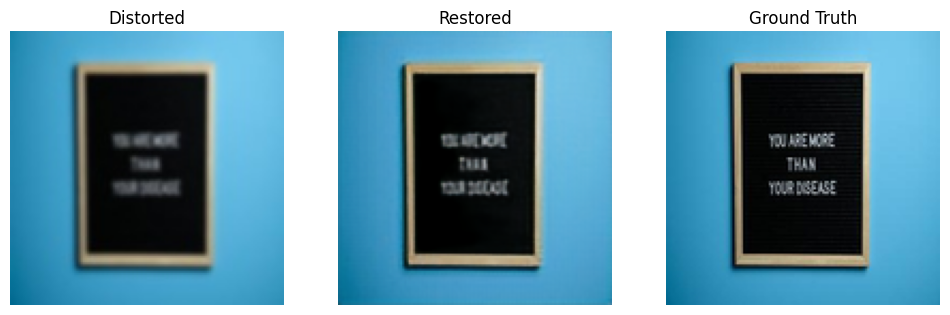

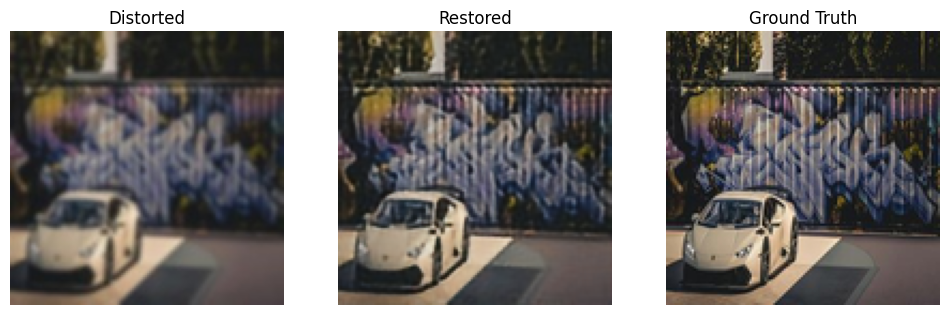

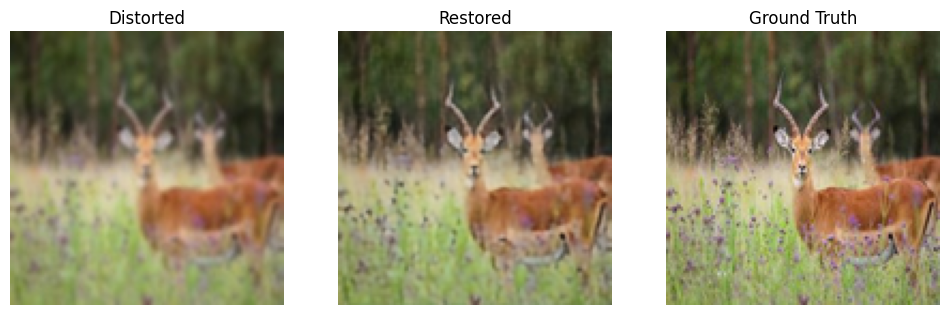

Epoch 11, Loss: 0.0245, Validation Loss: 0.0234
Validation PSNR: 29.91, SSIM: 0.9196,
Epoch 12, Loss: 0.0241, Validation Loss: 0.0242
Validation PSNR: 29.79, SSIM: 0.9211,
Epoch 13, Loss: 0.0239, Validation Loss: 0.0247
Validation PSNR: 29.69, SSIM: 0.9195,
Epoch 14, Loss: 0.0237, Validation Loss: 0.0227
Validation PSNR: 30.12, SSIM: 0.9160,
✅ Best model updated at epoch 14 with PSNR: 30.12
Epoch 15, Loss: 0.0237, Validation Loss: 0.0227
Validation PSNR: 30.16, SSIM: 0.9212,
✅ Best model updated at epoch 15 with PSNR: 30.16


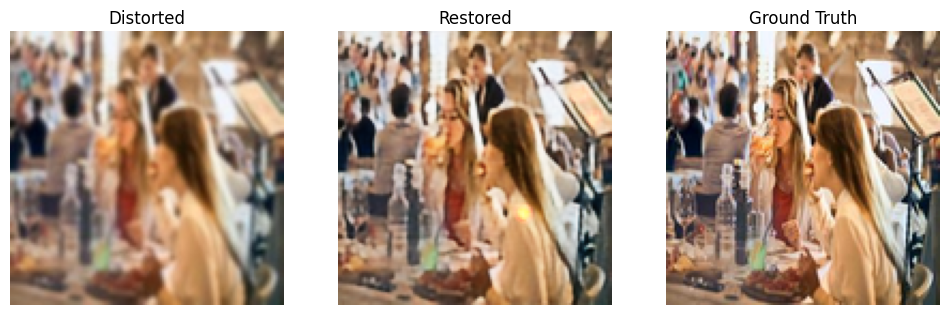

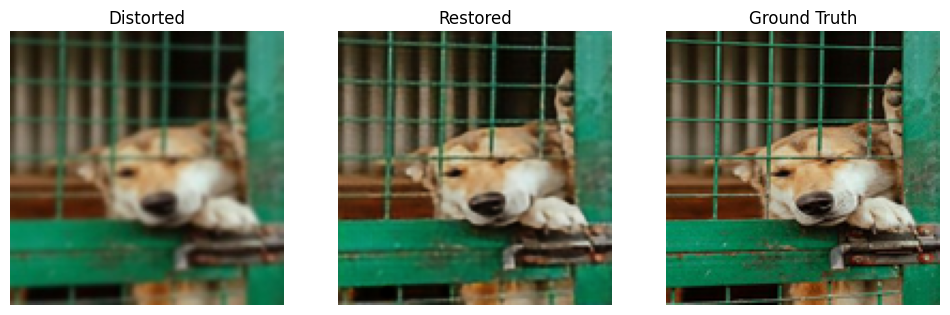

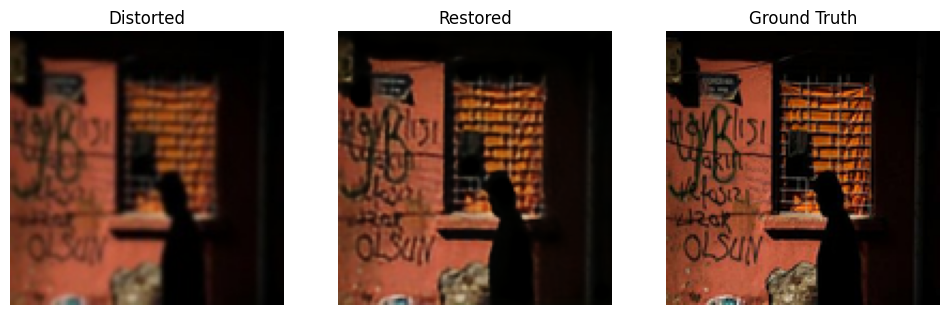

Epoch 16, Loss: 0.0235, Validation Loss: 0.0229
Validation PSNR: 30.09, SSIM: 0.9149,
Epoch 17, Loss: 0.0233, Validation Loss: 0.0228
Validation PSNR: 30.05, SSIM: 0.9163,
Epoch 18, Loss: 0.0232, Validation Loss: 0.0229
Validation PSNR: 29.99, SSIM: 0.9116,
Epoch 19, Loss: 0.0232, Validation Loss: 0.0253
Validation PSNR: 29.58, SSIM: 0.9210,
Epoch 20, Loss: 0.0230, Validation Loss: 0.0230
Validation PSNR: 29.96, SSIM: 0.9193,


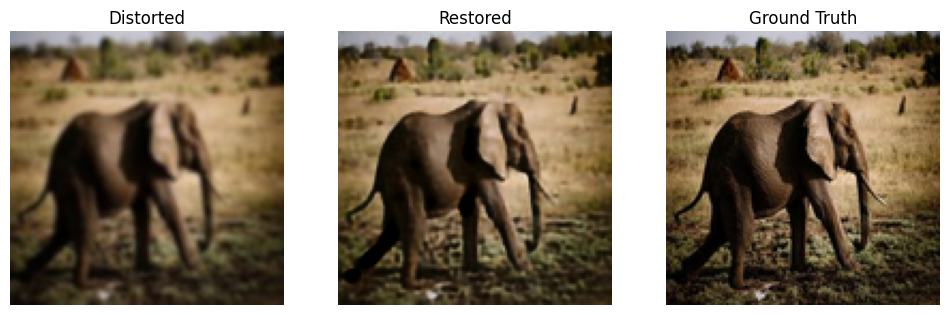

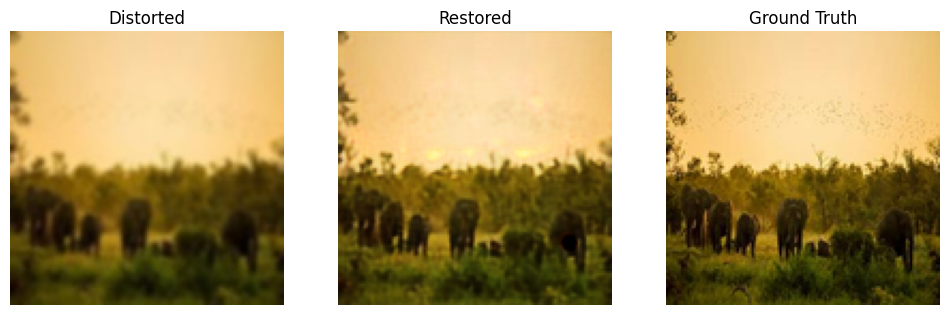

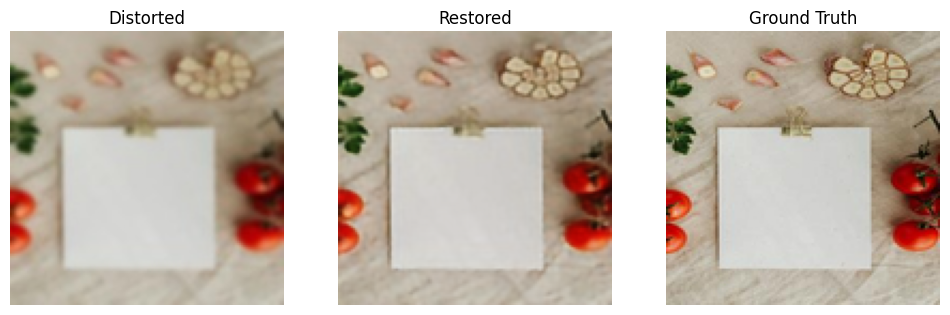

Epoch 21, Loss: 0.0223, Validation Loss: 0.0215
Validation PSNR: 30.50, SSIM: 0.9201,
✅ Best model updated at epoch 21 with PSNR: 30.50
Epoch 22, Loss: 0.0222, Validation Loss: 0.0215
Validation PSNR: 30.45, SSIM: 0.9256,
Epoch 23, Loss: 0.0221, Validation Loss: 0.0213
Validation PSNR: 30.45, SSIM: 0.9194,
Epoch 24, Loss: 0.0219, Validation Loss: 0.0215
Validation PSNR: 30.48, SSIM: 0.9217,
Epoch 25, Loss: 0.0220, Validation Loss: 0.0226
Validation PSNR: 30.23, SSIM: 0.9242,


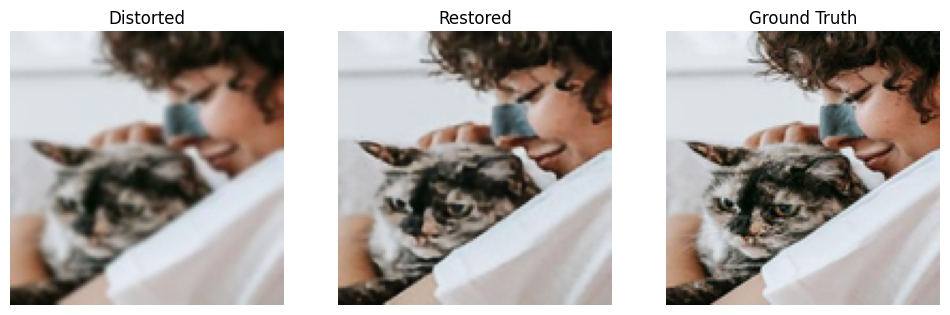

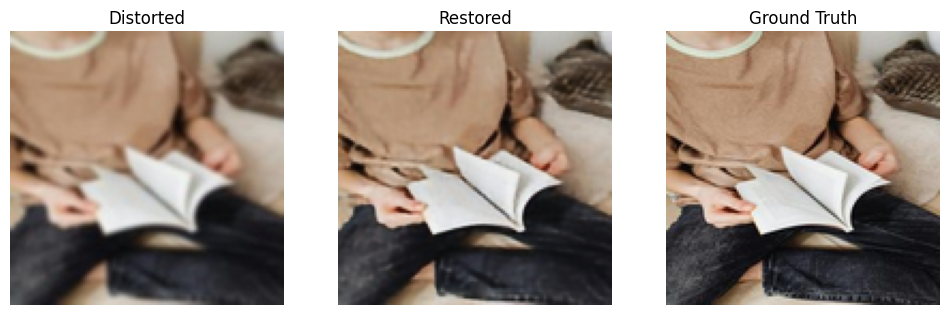

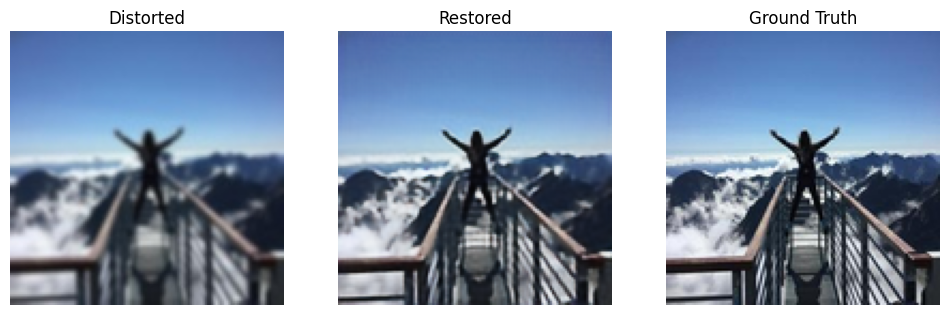

Epoch 26, Loss: 0.0220, Validation Loss: 0.0224
Validation PSNR: 30.28, SSIM: 0.9226,
Epoch 27, Loss: 0.0218, Validation Loss: 0.0244
Validation PSNR: 29.81, SSIM: 0.9265,
Epoch 28, Loss: 0.0218, Validation Loss: 0.0220
Validation PSNR: 30.37, SSIM: 0.9216,
Epoch 29, Loss: 0.0218, Validation Loss: 0.0204
Validation PSNR: 30.69, SSIM: 0.9234,
✅ Best model updated at epoch 29 with PSNR: 30.69
Epoch 30, Loss: 0.0217, Validation Loss: 0.0253
Validation PSNR: 29.62, SSIM: 0.9207,


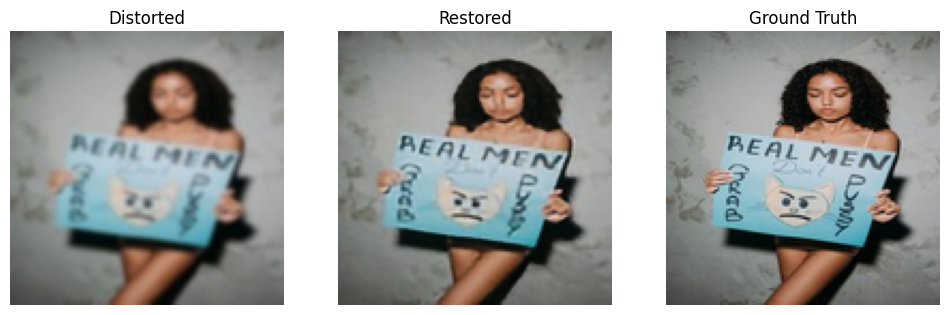

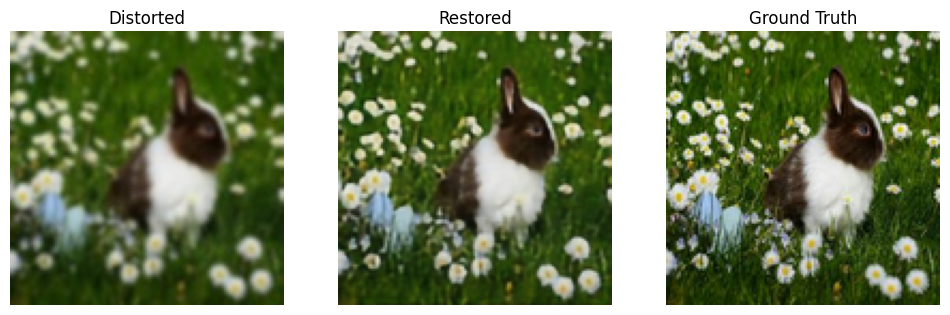

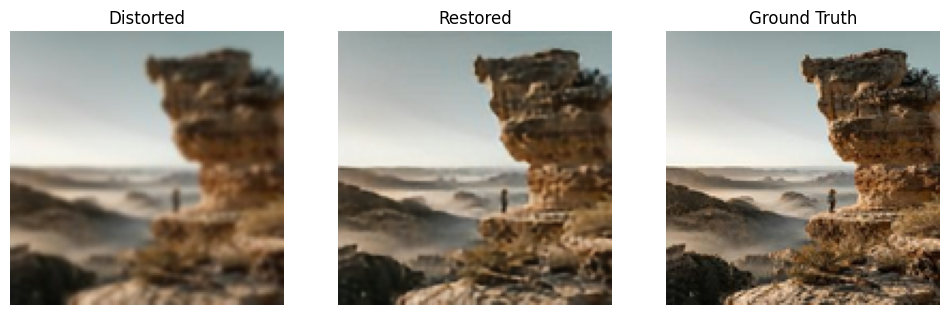

Epoch 31, Loss: 0.0214, Validation Loss: 0.0231
Validation PSNR: 30.12, SSIM: 0.9228,
Epoch 32, Loss: 0.0213, Validation Loss: 0.0231
Validation PSNR: 30.13, SSIM: 0.9175,
Epoch 33, Loss: 0.0213, Validation Loss: 0.0217
Validation PSNR: 30.44, SSIM: 0.9253,
Epoch 34, Loss: 0.0213, Validation Loss: 0.0231
Validation PSNR: 30.11, SSIM: 0.9248,
Epoch 35, Loss: 0.0212, Validation Loss: 0.0234
Validation PSNR: 30.08, SSIM: 0.9234,


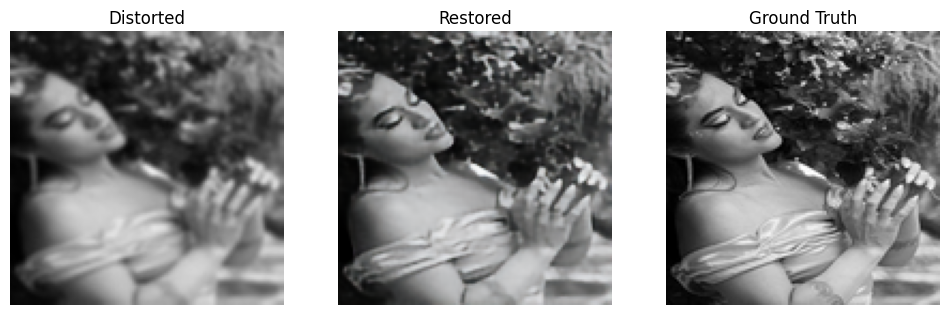

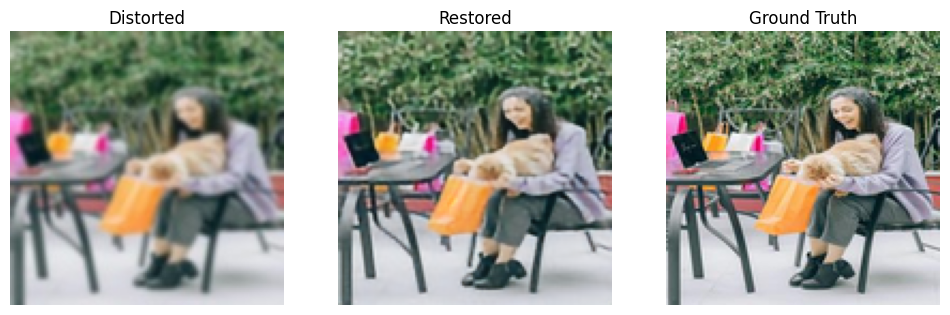

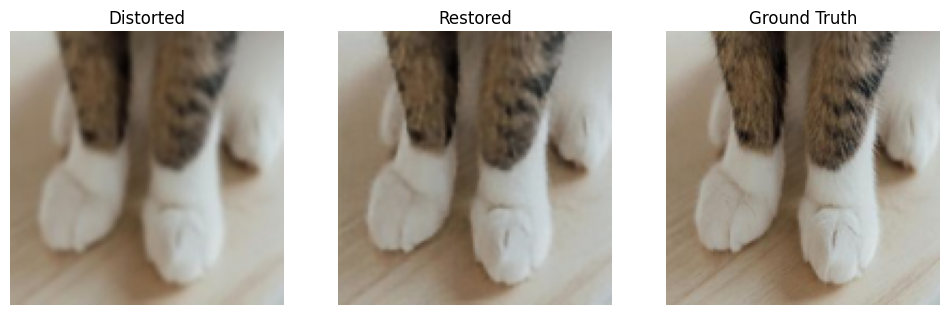

Epoch 36, Loss: 0.0212, Validation Loss: 0.0241
Validation PSNR: 29.93, SSIM: 0.9221,
Epoch 37, Loss: 0.0212, Validation Loss: 0.0219
Validation PSNR: 30.42, SSIM: 0.9233,
Epoch 38, Loss: 0.0212, Validation Loss: 0.0219
Validation PSNR: 30.38, SSIM: 0.9260,
Epoch 39, Loss: 0.0211, Validation Loss: 0.0212
Validation PSNR: 30.54, SSIM: 0.9252,
Epoch 40, Loss: 0.0210, Validation Loss: 0.0232
Validation PSNR: 30.09, SSIM: 0.9197,


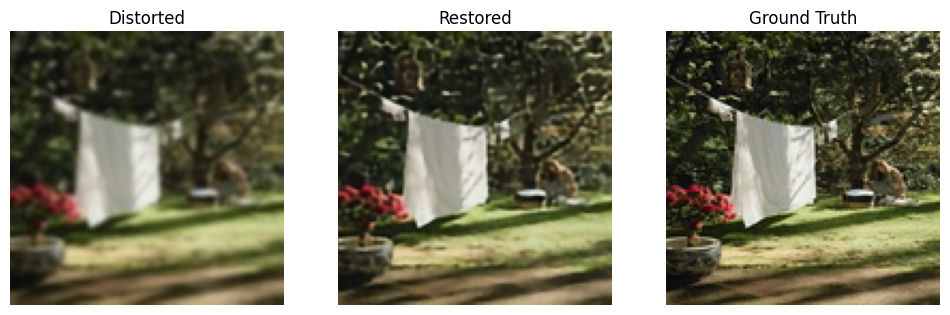

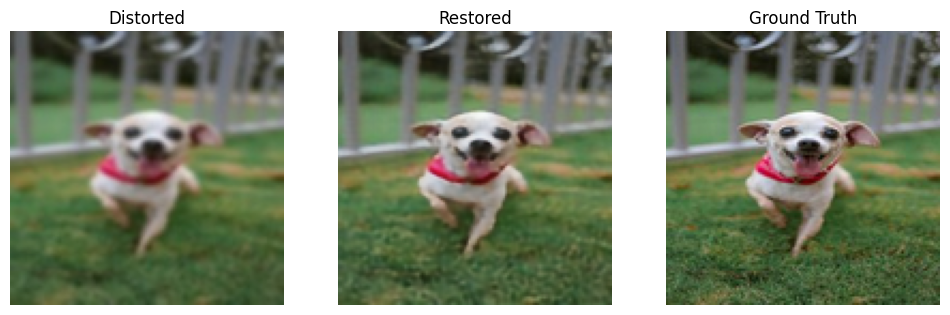

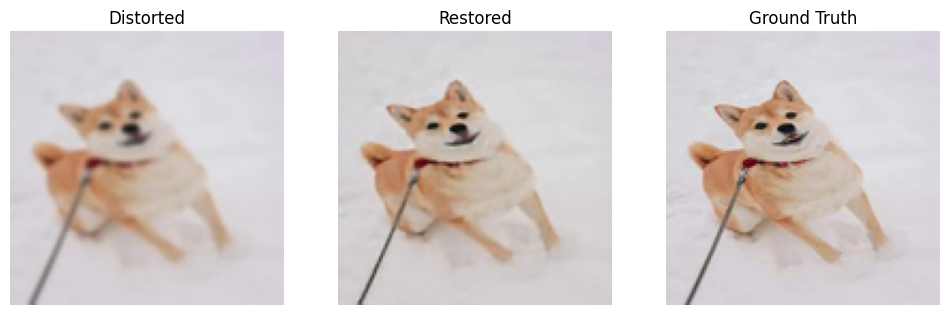

Epoch 41, Loss: 0.0209, Validation Loss: 0.0215
Validation PSNR: 30.50, SSIM: 0.9200,
Epoch 42, Loss: 0.0208, Validation Loss: 0.0227
Validation PSNR: 30.25, SSIM: 0.9243,
Epoch 43, Loss: 0.0208, Validation Loss: 0.0221
Validation PSNR: 30.36, SSIM: 0.9259,
Epoch 44, Loss: 0.0208, Validation Loss: 0.0221
Validation PSNR: 30.40, SSIM: 0.9278,
Epoch 45, Loss: 0.0208, Validation Loss: 0.0202
Validation PSNR: 30.81, SSIM: 0.9252,
✅ Best model updated at epoch 45 with PSNR: 30.81


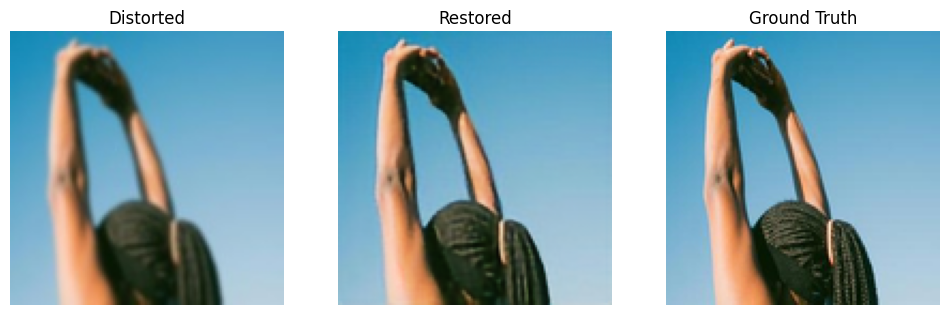

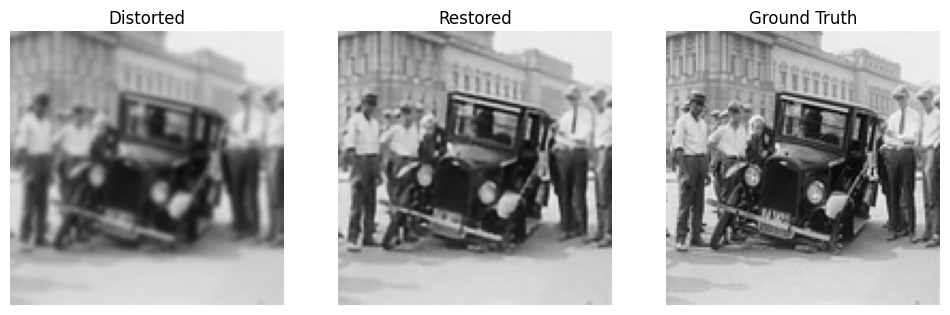

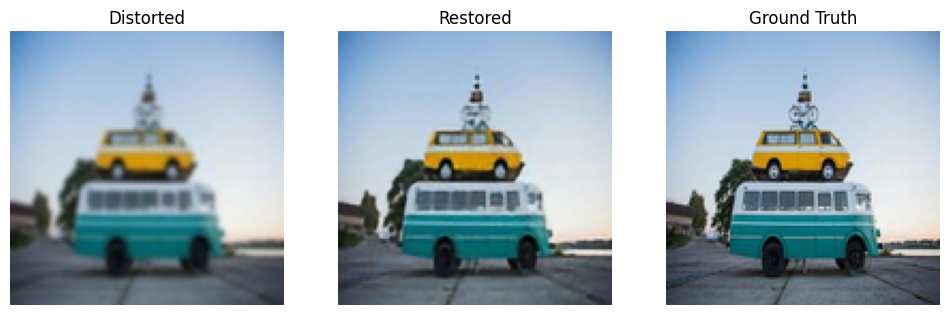

Epoch 46, Loss: 0.0209, Validation Loss: 0.0220
Validation PSNR: 30.39, SSIM: 0.9274,
Epoch 47, Loss: 0.0208, Validation Loss: 0.0220
Validation PSNR: 30.39, SSIM: 0.9281,
Epoch 48, Loss: 0.0208, Validation Loss: 0.0208
Validation PSNR: 30.67, SSIM: 0.9291,
Epoch 49, Loss: 0.0209, Validation Loss: 0.0200
Validation PSNR: 30.86, SSIM: 0.9282,
✅ Best model updated at epoch 49 with PSNR: 30.86
Epoch 50, Loss: 0.0208, Validation Loss: 0.0222
Validation PSNR: 30.37, SSIM: 0.9232,


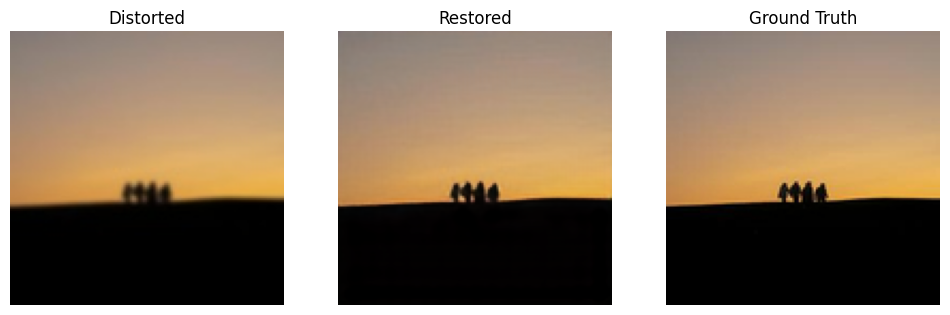

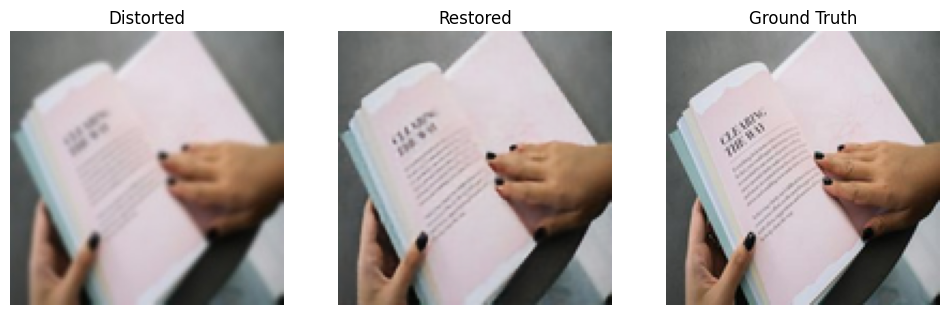

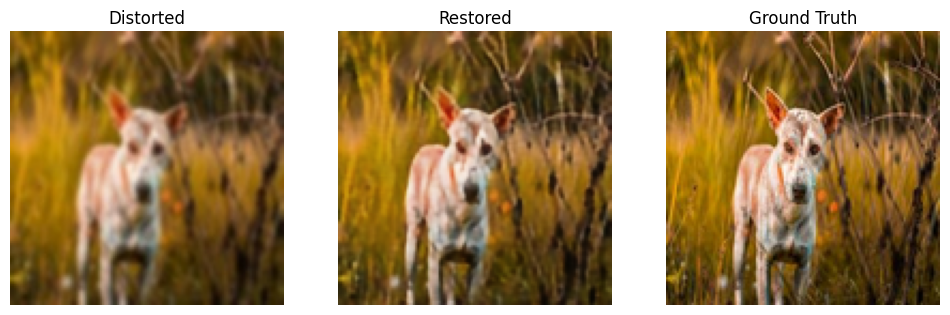

Epoch 51, Loss: 0.0207, Validation Loss: 0.0210
Validation PSNR: 30.63, SSIM: 0.9267,
Epoch 52, Loss: 0.0207, Validation Loss: 0.0213
Validation PSNR: 30.58, SSIM: 0.9249,
Epoch 53, Loss: 0.0206, Validation Loss: 0.0211
Validation PSNR: 30.61, SSIM: 0.9274,
Epoch 54, Loss: 0.0207, Validation Loss: 0.0247
Validation PSNR: 29.81, SSIM: 0.9174,
Epoch 55, Loss: 0.0207, Validation Loss: 0.0211
Validation PSNR: 30.62, SSIM: 0.9292,


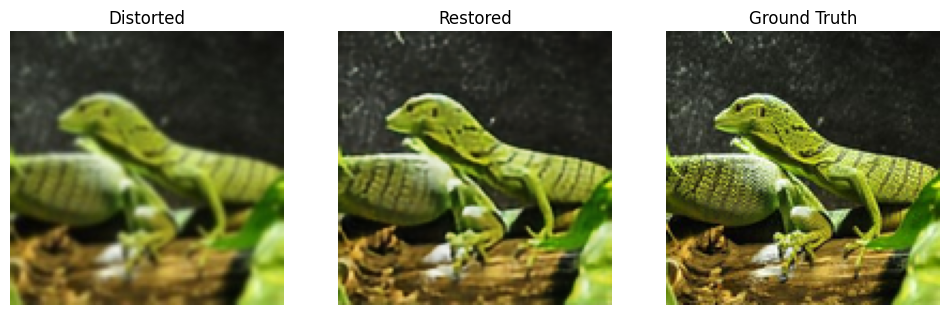

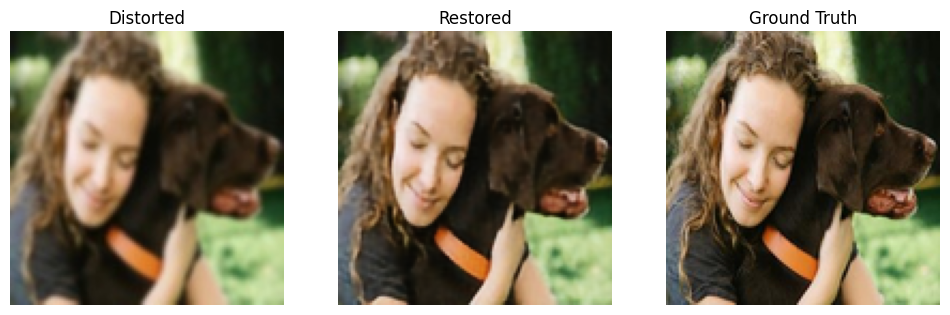

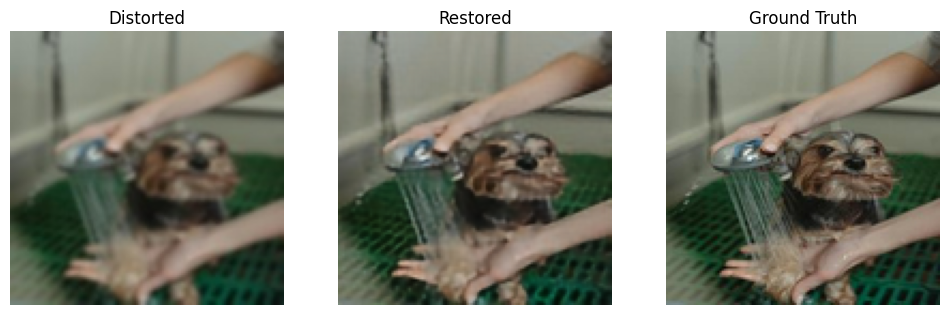

Epoch 56, Loss: 0.0207, Validation Loss: 0.0223
Validation PSNR: 30.33, SSIM: 0.9274,
Epoch 57, Loss: 0.0206, Validation Loss: 0.0241
Validation PSNR: 29.93, SSIM: 0.9230,
Epoch 58, Loss: 0.0206, Validation Loss: 0.0207
Validation PSNR: 30.72, SSIM: 0.9287,
Epoch 59, Loss: 0.0206, Validation Loss: 0.0246
Validation PSNR: 29.82, SSIM: 0.9173,
Epoch 60, Loss: 0.0207, Validation Loss: 0.0223
Validation PSNR: 30.35, SSIM: 0.9258,


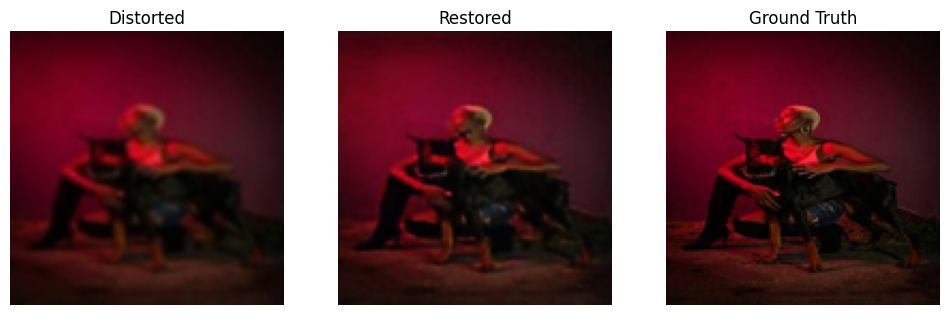

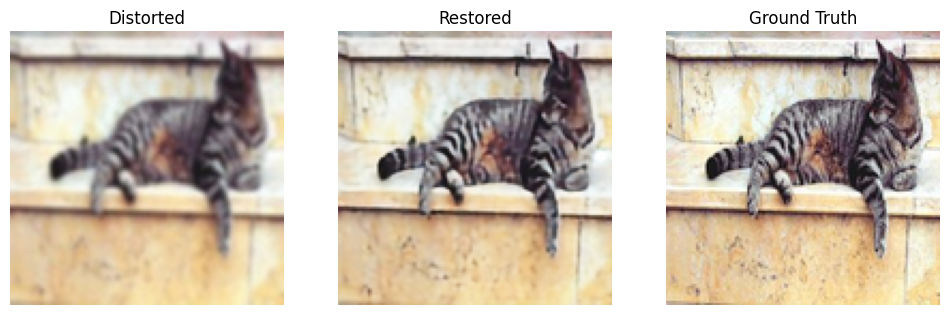

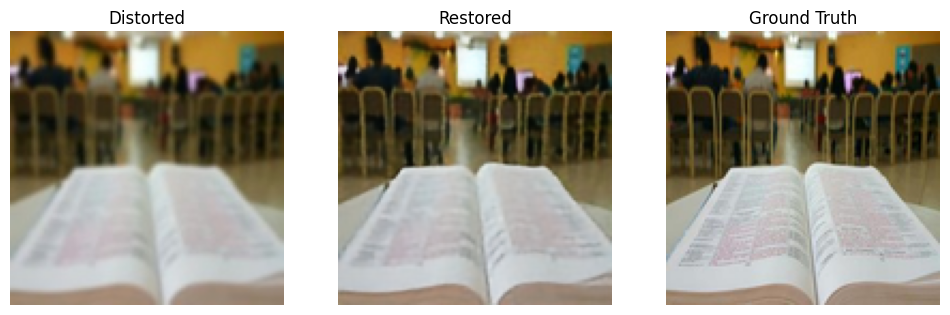

Epoch 61, Loss: 0.0206, Validation Loss: 0.0216
Validation PSNR: 30.47, SSIM: 0.9263,
Epoch 62, Loss: 0.0206, Validation Loss: 0.0224
Validation PSNR: 30.32, SSIM: 0.9248,
Epoch 63, Loss: 0.0206, Validation Loss: 0.0207
Validation PSNR: 30.70, SSIM: 0.9267,
Epoch 64, Loss: 0.0206, Validation Loss: 0.0211
Validation PSNR: 30.57, SSIM: 0.9222,
Epoch 65, Loss: 0.0206, Validation Loss: 0.0214
Validation PSNR: 30.54, SSIM: 0.9253,


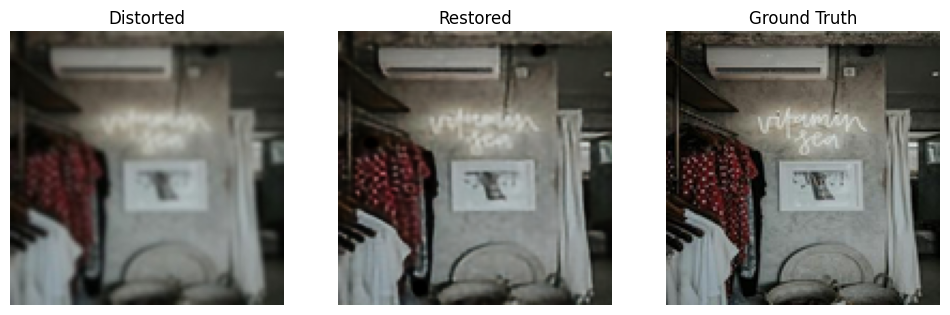

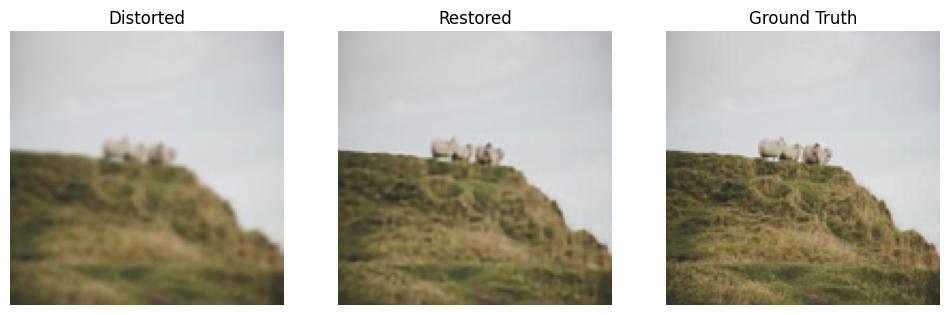

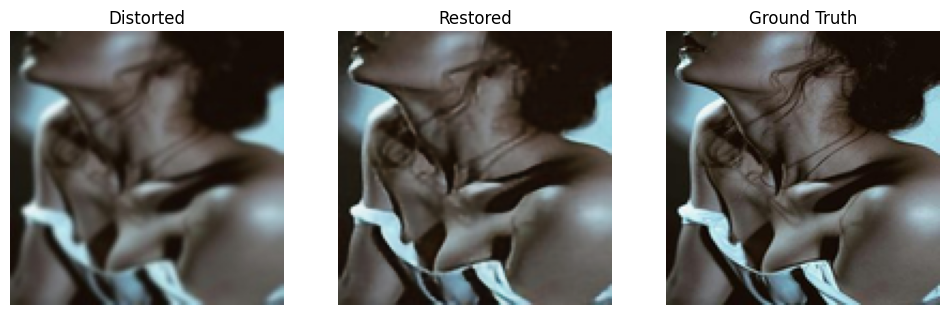

Epoch 66, Loss: 0.0206, Validation Loss: 0.0220
Validation PSNR: 30.42, SSIM: 0.9257,
Epoch 67, Loss: 0.0206, Validation Loss: 0.0233
Validation PSNR: 30.05, SSIM: 0.9275,
Epoch 68, Loss: 0.0205, Validation Loss: 0.0198
Validation PSNR: 30.90, SSIM: 0.9261,
✅ Best model updated at epoch 68 with PSNR: 30.90
Epoch 69, Loss: 0.0205, Validation Loss: 0.0205
Validation PSNR: 30.75, SSIM: 0.9258,
Epoch 70, Loss: 0.0205, Validation Loss: 0.0213
Validation PSNR: 30.56, SSIM: 0.9246,


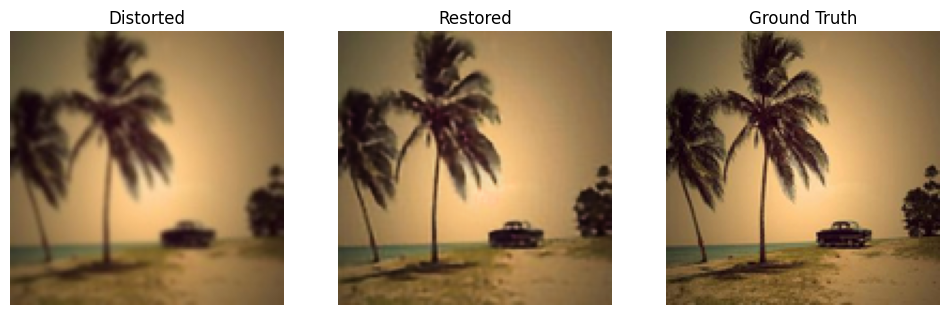

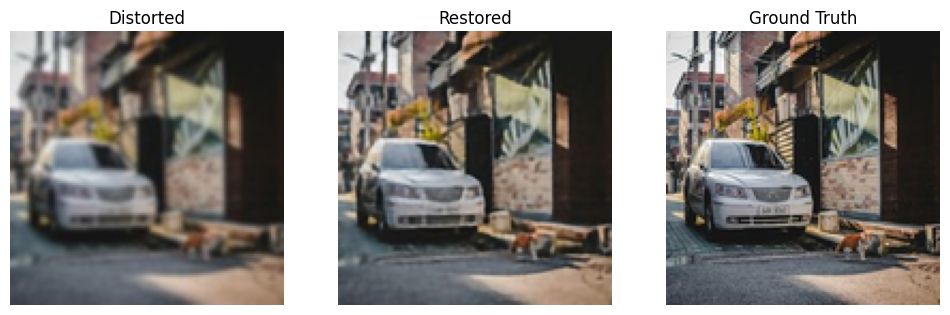

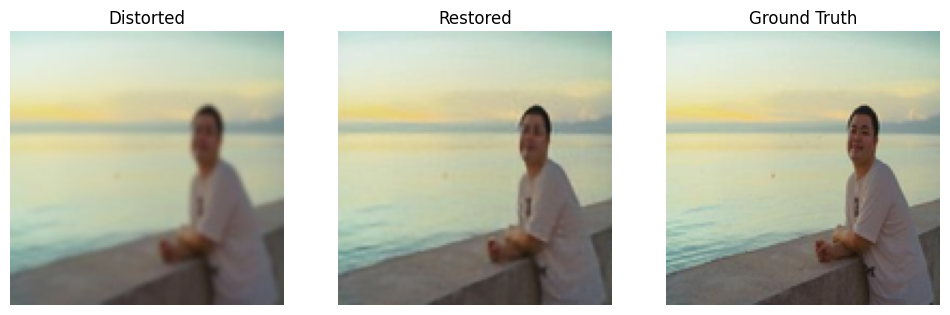

Epoch 71, Loss: 0.0205, Validation Loss: 0.0235
Validation PSNR: 30.08, SSIM: 0.9187,
Epoch 72, Loss: 0.0205, Validation Loss: 0.0214
Validation PSNR: 30.52, SSIM: 0.9191,
Epoch 73, Loss: 0.0205, Validation Loss: 0.0232
Validation PSNR: 30.18, SSIM: 0.9192,
Epoch 74, Loss: 0.0205, Validation Loss: 0.0223
Validation PSNR: 30.34, SSIM: 0.9260,
Epoch 75, Loss: 0.0206, Validation Loss: 0.0205
Validation PSNR: 30.75, SSIM: 0.9267,


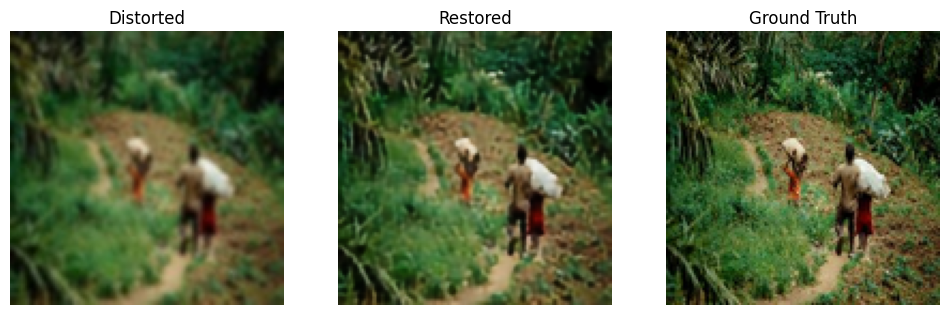

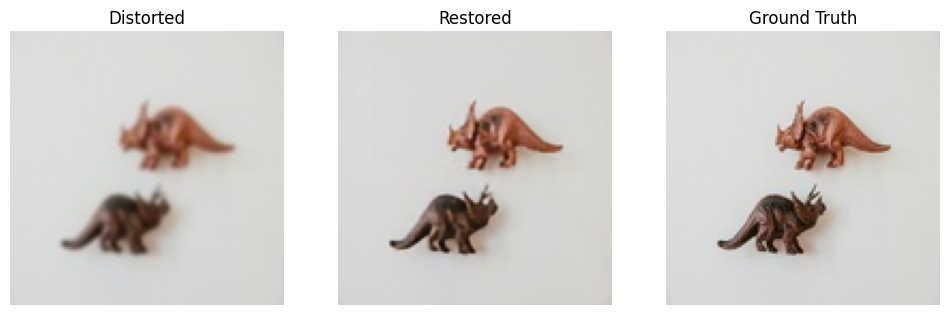

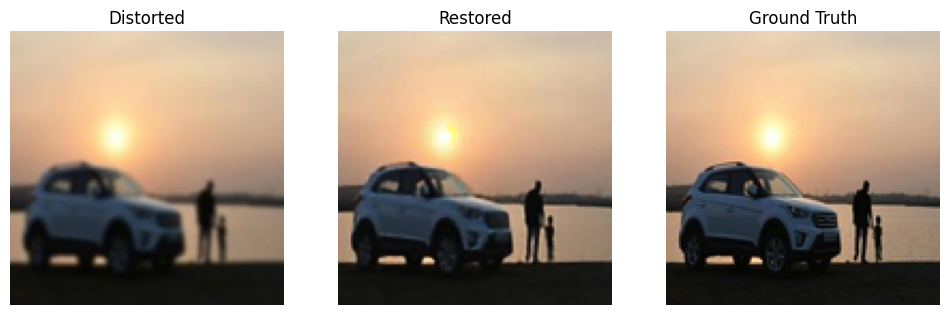

Epoch 76, Loss: 0.0205, Validation Loss: 0.0205
Validation PSNR: 30.76, SSIM: 0.9267,
Epoch 77, Loss: 0.0205, Validation Loss: 0.0204
Validation PSNR: 30.77, SSIM: 0.9243,
Epoch 78, Loss: 0.0206, Validation Loss: 0.0212
Validation PSNR: 30.60, SSIM: 0.9240,
Epoch 79, Loss: 0.0205, Validation Loss: 0.0205
Validation PSNR: 30.77, SSIM: 0.9275,
Epoch 80, Loss: 0.0205, Validation Loss: 0.0224
Validation PSNR: 30.32, SSIM: 0.9216,


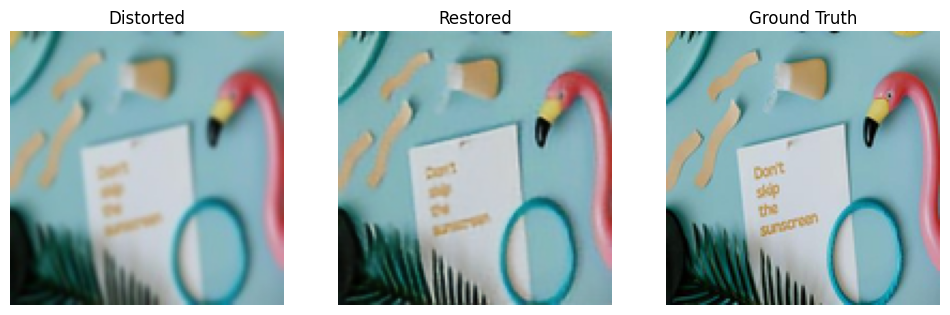

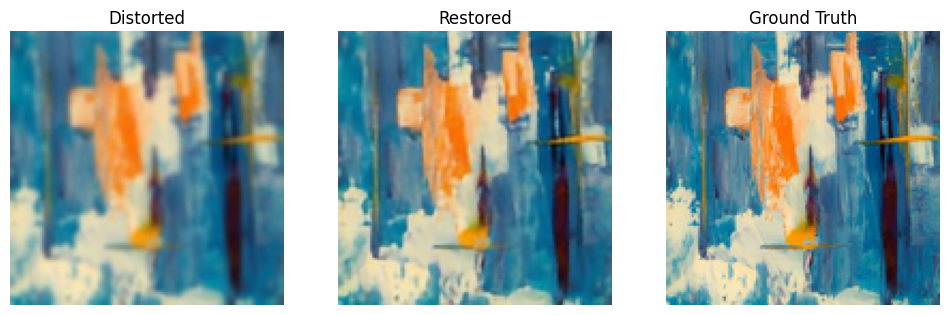

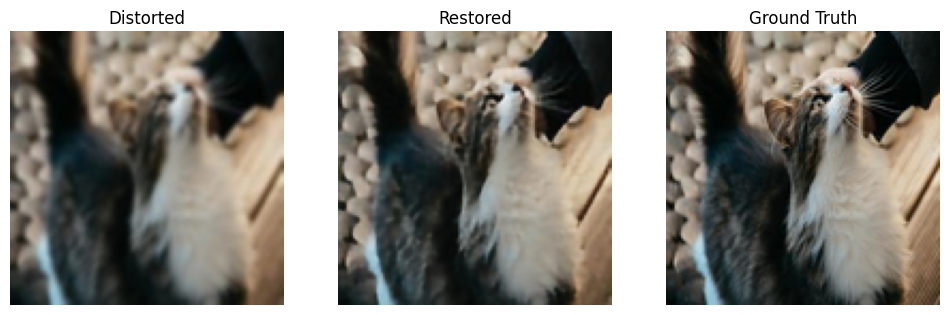

Epoch 81, Loss: 0.0205, Validation Loss: 0.0226
Validation PSNR: 30.27, SSIM: 0.9204,
Epoch 82, Loss: 0.0205, Validation Loss: 0.0220
Validation PSNR: 30.41, SSIM: 0.9237,
Epoch 83, Loss: 0.0204, Validation Loss: 0.0212
Validation PSNR: 30.58, SSIM: 0.9223,
Epoch 84, Loss: 0.0205, Validation Loss: 0.0204
Validation PSNR: 30.77, SSIM: 0.9294,
Epoch 85, Loss: 0.0205, Validation Loss: 0.0216
Validation PSNR: 30.52, SSIM: 0.9264,


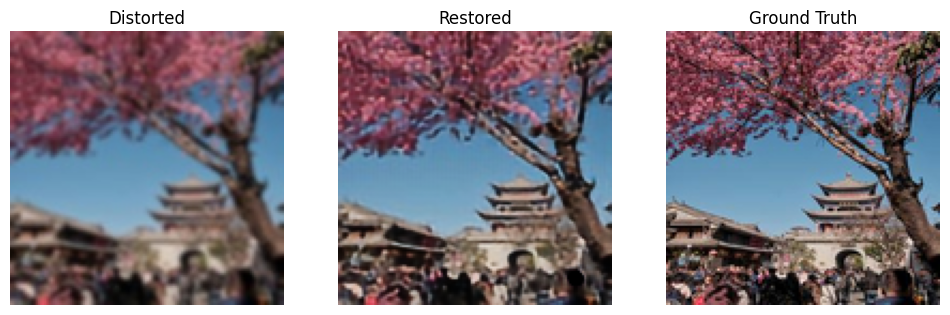

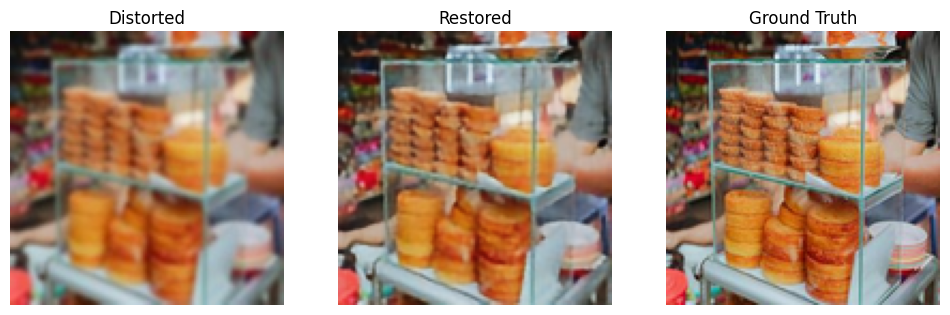

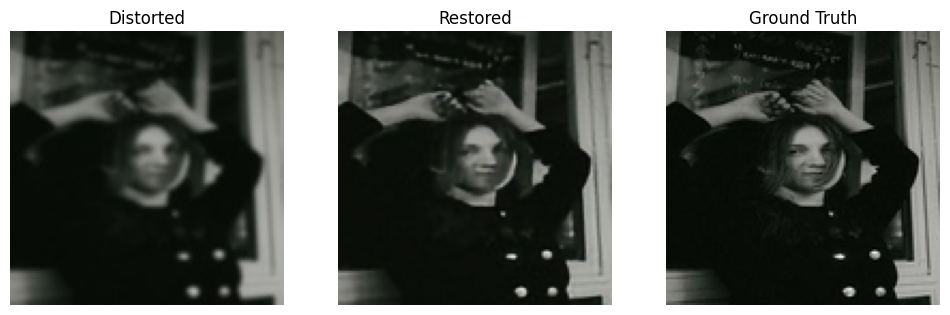

Epoch 86, Loss: 0.0205, Validation Loss: 0.0215
Validation PSNR: 30.53, SSIM: 0.9213,
Epoch 87, Loss: 0.0204, Validation Loss: 0.0213
Validation PSNR: 30.57, SSIM: 0.9228,
Epoch 88, Loss: 0.0205, Validation Loss: 0.0210
Validation PSNR: 30.66, SSIM: 0.9262,
Epoch 89, Loss: 0.0205, Validation Loss: 0.0207
Validation PSNR: 30.71, SSIM: 0.9255,
Epoch 90, Loss: 0.0205, Validation Loss: 0.0228
Validation PSNR: 30.23, SSIM: 0.9158,


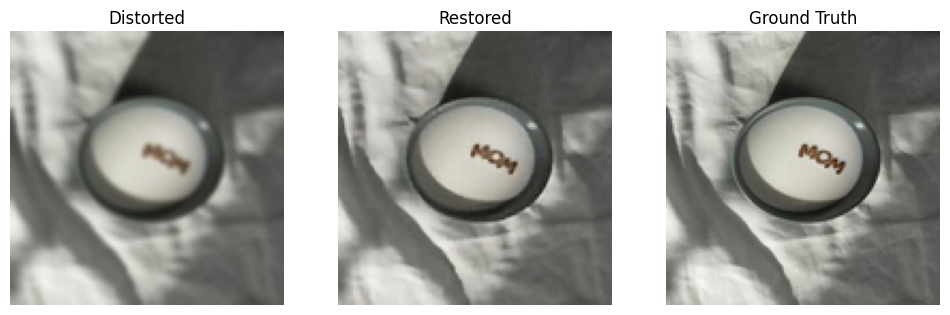

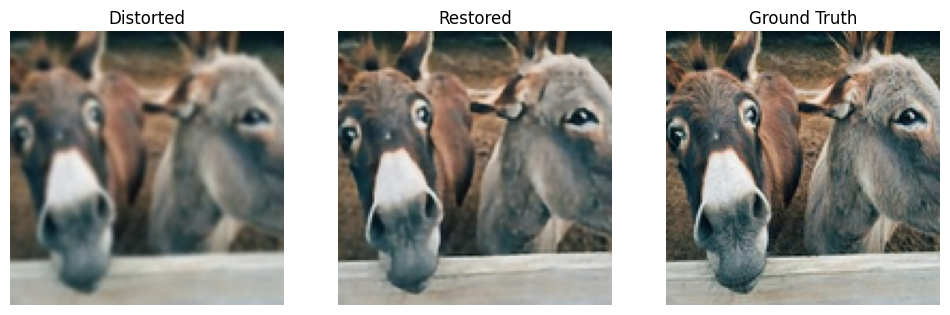

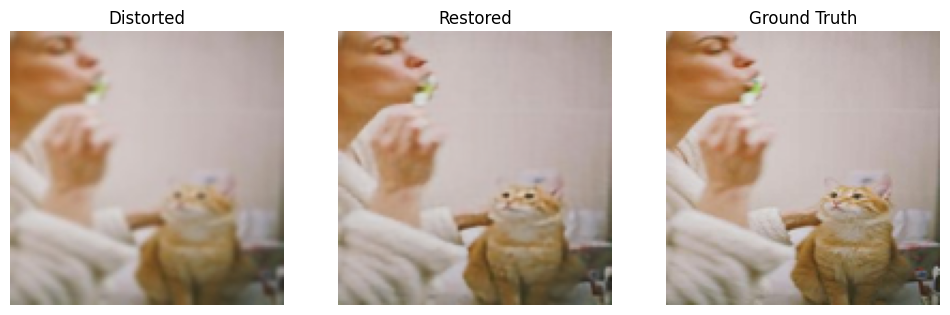

Epoch 91, Loss: 0.0205, Validation Loss: 0.0223
Validation PSNR: 30.36, SSIM: 0.9252,
Epoch 92, Loss: 0.0205, Validation Loss: 0.0218
Validation PSNR: 30.42, SSIM: 0.9247,
Epoch 93, Loss: 0.0204, Validation Loss: 0.0240
Validation PSNR: 29.97, SSIM: 0.9210,
Epoch 94, Loss: 0.0205, Validation Loss: 0.0215
Validation PSNR: 30.54, SSIM: 0.9247,
Epoch 95, Loss: 0.0205, Validation Loss: 0.0220
Validation PSNR: 30.45, SSIM: 0.9222,


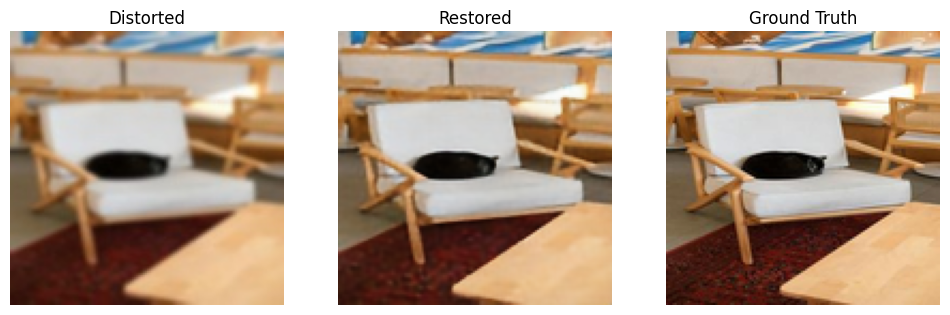

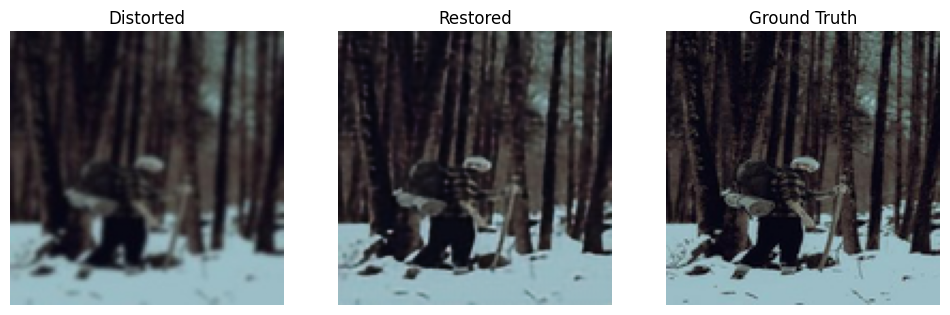

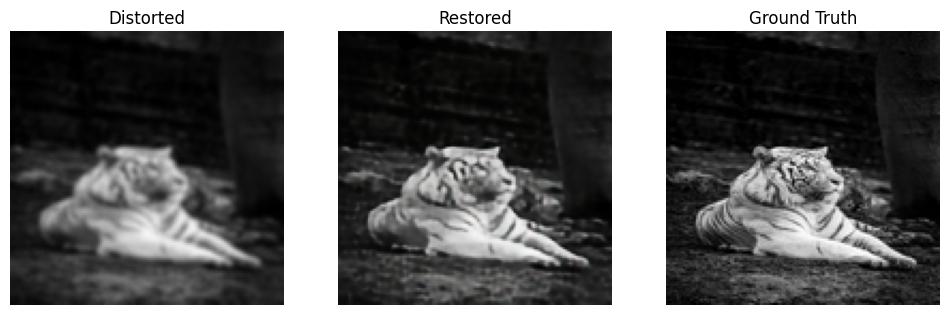

Epoch 96, Loss: 0.0205, Validation Loss: 0.0224
Validation PSNR: 30.32, SSIM: 0.9276,
Epoch 97, Loss: 0.0205, Validation Loss: 0.0217
Validation PSNR: 30.49, SSIM: 0.9259,
Epoch 98, Loss: 0.0205, Validation Loss: 0.0199
Validation PSNR: 30.89, SSIM: 0.9239,
Epoch 99, Loss: 0.0204, Validation Loss: 0.0239
Validation PSNR: 29.97, SSIM: 0.9255,
Epoch 100, Loss: 0.0205, Validation Loss: 0.0231
Validation PSNR: 30.13, SSIM: 0.9274,


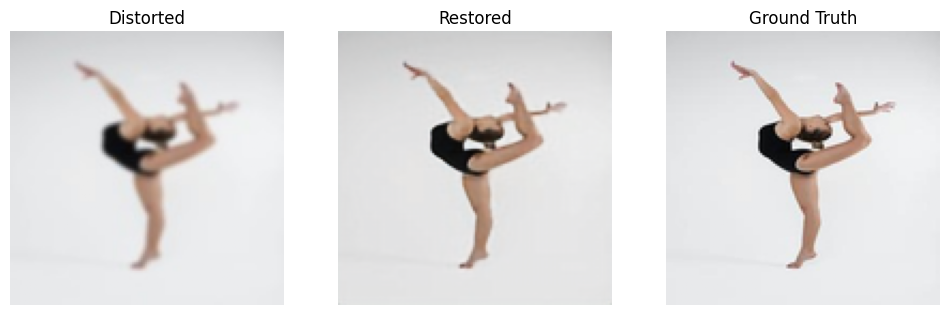

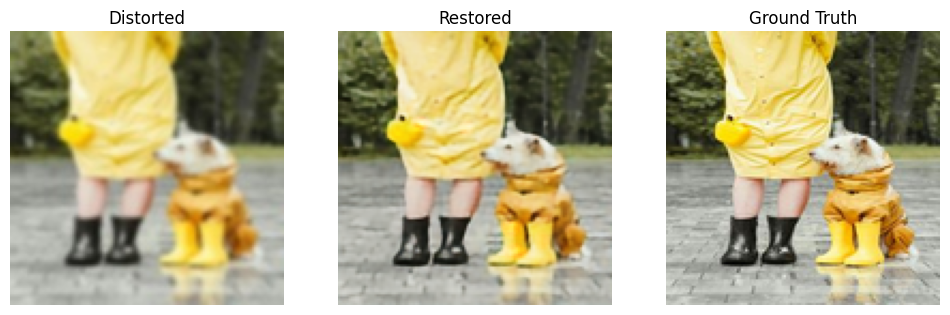

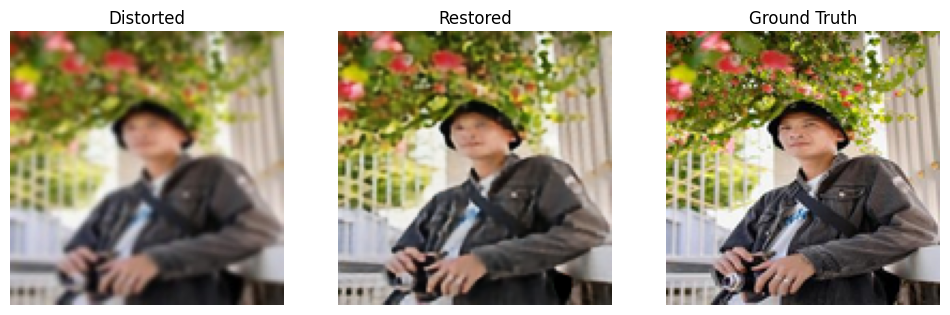

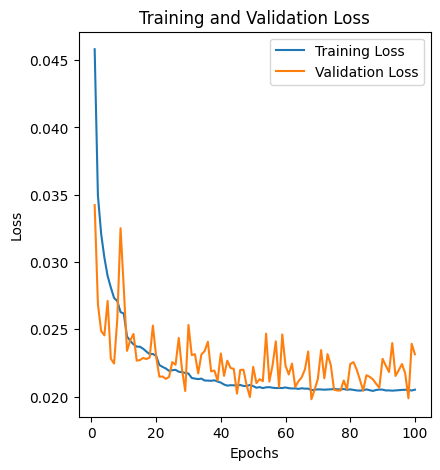

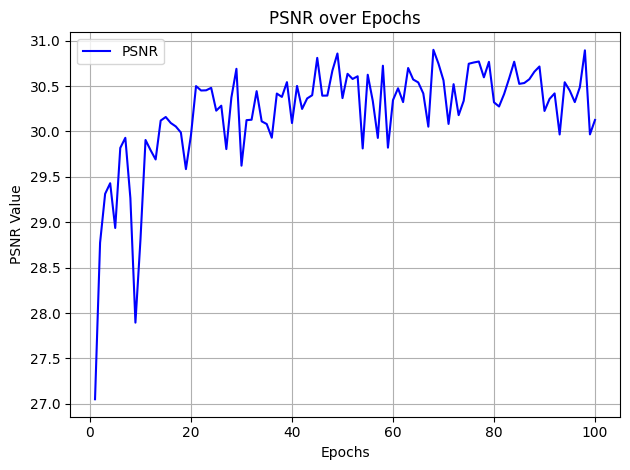

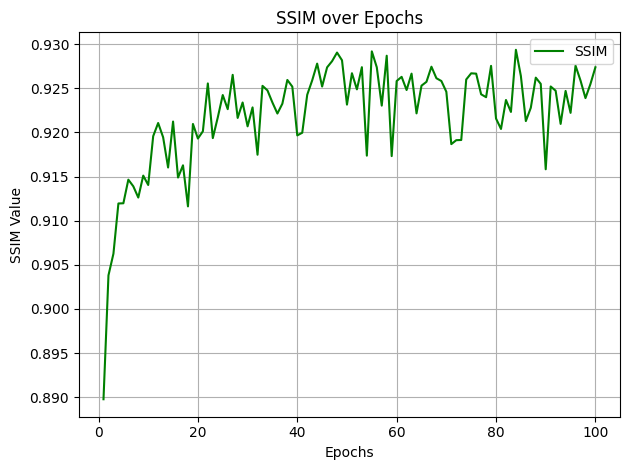

In [ ]:
import os
import torch
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import transforms
from skimage.metrics import structural_similarity as ssim
import numpy as np
from skimage.metrics import peak_signal_noise_ratio as psnr
# Create necessary directories
os.makedirs("model_deblur_main_1024", exist_ok=True)    
os.makedirs("model_deblur_main_BestModel_1024", exist_ok=True)

if __name__ == '__main__':
    # Directories for training and validation
    train_distorted_dir = "unet_train_deblur/blured_128x128"
    train_clear_dir = "unet_train_deblur/clear_128x128"
    val_distorted_dir = "validation/blur128x128"
    val_clear_dir = "validation/clear128x128"

    transform = transforms.Compose([transforms.ToTensor()])

    # Create datasets for training and validation
    train_dataset = ImageRestorationDataset(train_distorted_dir, train_clear_dir, transform)
    val_dataset = ImageRestorationDataset(val_distorted_dir, val_clear_dir, transform)

    # Create dataloaders for training and validation
    train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
    val_dataloader = DataLoader(val_dataset, batch_size=8, shuffle=False)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")

    model = UNet().to(device)
    
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.5)
    criterion = torch.nn.L1Loss()

    best_psnr = 0.0
    train_losses = []
    val_losses = []
    psnr_history = []
    ssim_history = []
    ep=100

    # Training loop
    for epoch in range(1, ep+1):
        # Training step
        loss = train(model, train_dataloader, optimizer, criterion, device)
        train_losses.append(loss)
        scheduler.step()  # Update learning rate after each epoch

        # Evaluate on validation set
        avg_psnr, avg_ssim = evaluate(model, val_dataloader, device)
        val_loss=validate_epoch(model, val_dataloader, criterion, device)
        val_losses.append(val_loss)

        # Track PSNR and SSIM
        psnr_history.append(avg_psnr)
        ssim_history.append(avg_ssim)

        print(f"Epoch {epoch}, Loss: {loss:.4f}, Validation Loss: {val_loss:.4f}")
        print(f"Validation PSNR: {avg_psnr:.2f}, SSIM: {avg_ssim:.4f},")
        checkpoint = {
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'loss': loss,
            'best_psnr': best_psnr,
        }
        torch.save(checkpoint, f"model_deblur_main_BestModel_1024/full_checkpoint_epoch_{epoch}.pth")
        # Save best model based on PSNR
        if avg_psnr > best_psnr:
            best_psnr = avg_psnr
            torch.save(model.state_dict(), f"model_deblur_main_BestModel_1024/best_psnr_model_main_epoch_{epoch}.pth")
            print(f"✅ Best model updated at epoch {epoch} with PSNR: {avg_psnr:.2f}")

        # Save model every 5 epochs and full checkpoint
        if epoch % 5 == 0:
            torch.save(model.state_dict(), f"model_deblur_main_1024/unet_deblur_epoch_{epoch}.pth")
            # Visualize sample (optional)
            visualize_sample(model, train_dataloader, device)
    # Optionally, save the final model
    torch.save(model.state_dict(), "unet_deblur_21k_main_Final.pth")
    # Plotting training and validation losses
    plt.figure(figsize=(10,5))
    plt.subplot(1, 2, 1)
    plt.plot(range(1, ep+1), train_losses, label='Training Loss')
    plt.plot(range(1, ep+1), val_losses, label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.title('Training and Validation Loss')
        # Plotting PSNR and SSIM
    plt.figure()
    plt.plot(range(1, ep+1), psnr_history, label='PSNR', color='blue')
    plt.xlabel('Epochs')
    plt.ylabel('PSNR Value')
    plt.title('PSNR over Epochs')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Plot SSIM
    plt.figure()
    plt.plot(range(1, ep+1), ssim_history, label='SSIM', color='green')
    plt.xlabel('Epochs')
    plt.ylabel('SSIM Value')
    plt.title('SSIM over Epochs')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

Resume from checkpoint

In [29]:
# import os
# import torch
# import matplotlib.pyplot as plt
# from torch.utils.data import DataLoader
# from torchvision import transforms
# from skimage.metrics import structural_similarity as ssim
# from skimage.metrics import peak_signal_noise_ratio as psnr
# import numpy as np

# # ======= Import your custom classes/functions ===========
# # Assuming these are defined in your codebase
# # from your_module import ImageRestorationDataset, UNet, train, evaluate, validate_epoch, visualize_sample
# # Replace above with actual definitions or imports if needed

# # ========== Setup ==========
# os.makedirs("model_deblur_main2_checkpoint", exist_ok=True)

# # Training Parameters
# ep = 20
# checkpoint_path = "model_deblur_main2/full_checkpoint_epoch_10.pth"
# start_epoch = 11

# # Dataset paths
# train_distorted_dir = "unet_train_deblur/blured_128x128"
# train_clear_dir = "unet_train_deblur/clear_128x128"
# val_distorted_dir = "processed_images/blur128x128"
# val_clear_dir = "processed_images/clear128x128"

# transform = transforms.Compose([transforms.ToTensor()])

# # Datasets and DataLoaders
# train_dataset = ImageRestorationDataset(train_distorted_dir, train_clear_dir, transform)
# val_dataset = ImageRestorationDataset(val_distorted_dir, val_clear_dir, transform)
# train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
# val_dataloader = DataLoader(val_dataset, batch_size=8, shuffle=False)

# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# print(f"Using device: {device}")

# # Model and Optimizer
# model = UNet().to(device)
# optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
# scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.5)
# criterion = torch.nn.L1Loss()

# # Resume from checkpoint if exists
# best_psnr = 0.0
# train_losses = []
# val_losses = []
# psnr_history = []
# ssim_history = []

# if os.path.exists(checkpoint_path):
#     checkpoint = torch.load(checkpoint_path, map_location=device, weights_only=False)

#     model.load_state_dict(checkpoint['model_state_dict'])
#     optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
#     start_epoch = checkpoint['epoch'] + 1
#     best_psnr = checkpoint.get('best_psnr', 0.0)
#     print(f"✅ Resumed from checkpoint at epoch {checkpoint['epoch']}")

# # ========== Training Loop ==========
# for epoch in range(start_epoch, ep + 1):
#     # Training step
#     loss = train(model, train_dataloader, optimizer, criterion, device)
#     train_losses.append(loss)
#     scheduler.step()

#     # Validation
#     val_loss = validate_epoch(model, val_dataloader, criterion, device)
#     val_losses.append(val_loss)
#     avg_psnr, avg_ssim = evaluate(model, val_dataloader, device)
#     psnr_history.append(avg_psnr)
#     ssim_history.append(avg_ssim)

#     print(f"Epoch {epoch}, Loss: {loss:.4f}, Val Loss: {val_loss:.4f}")
#     print(f"Validation PSNR: {avg_psnr:.2f}, SSIM: {avg_ssim:.4f}")

#     # Save checkpoint
#     checkpoint = {
#         'epoch': epoch,
#         'model_state_dict': model.state_dict(),
#         'optimizer_state_dict': optimizer.state_dict(),
#         'loss': loss,
#         'best_psnr': best_psnr,
#     }
#     torch.save(checkpoint, f"model_deblur_main2_checkpoint/full_checkpoint_epoch_{epoch}.pth")

#     # Save best model
#     if avg_psnr > best_psnr:
#         best_psnr = avg_psnr
#         torch.save(model.state_dict(), f"model_deblur_main2_checkpoint/best_psnr_model_main_epoch_{epoch}.pth")
#         print(f"✅ Best model updated at epoch {epoch} with PSNR: {avg_psnr:.2f}")

#     # Save every 5 epochs
#     if epoch % 5 == 0:
#         torch.save(model.state_dict(), f"model_deblur_main2_checkpoint/unet_deblur_epoch_{epoch}.pth")
#         visualize_sample(model, train_dataloader, device)

# # Final model
# torch.save(model.state_dict(), "unet_deblur_21k_main_TEST_checkpoint.pth")

# # ========== Plotting ==========
# plt.figure(figsize=(10, 5))
# plt.subplot(1, 2, 1)
# plt.plot(range(start_epoch, ep + 1), train_losses, label='Training Loss')
# plt.plot(range(start_epoch, ep + 1), val_losses, label='Validation Loss')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()
# plt.title('Training and Validation Loss')

# plt.subplot(1, 2, 2)
# plt.plot(range(start_epoch, ep + 1), psnr_history, label='PSNR')
# plt.plot(range(start_epoch, ep + 1), ssim_history, label='SSIM')
# plt.xlabel('Epochs')
# plt.ylabel('Value')
# plt.legend()
# plt.title('PSNR and SSIM')

# plt.tight_layout()
# plt.show()


TESTING

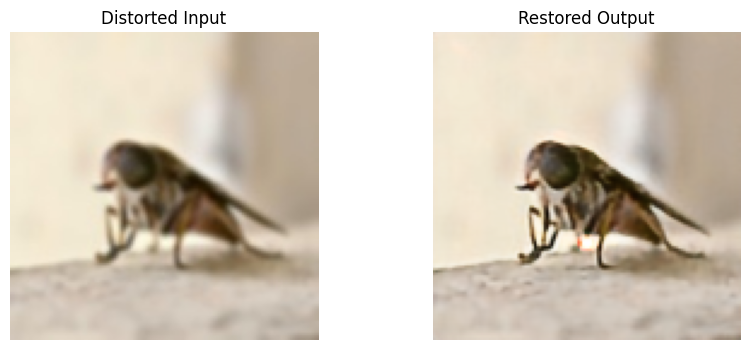

In [13]:
import torch
from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as transforms

# Re-create your model architecture (UNet in this case)
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()

        def conv_block(in_channels, out_channels):
            return nn.Sequential(
                nn.Conv2d(in_channels, out_channels, 3, padding=1),
                nn.BatchNorm2d(out_channels),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_channels, out_channels, 3, padding=1),
                nn.BatchNorm2d(out_channels),
                nn.ReLU(inplace=True)
            )

        def up_block(in_channels, out_channels):
            return nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)

        self.enc1 = conv_block(3, 64)
        self.pool1 = nn.MaxPool2d(2)
        self.enc2 = conv_block(64, 128)
        self.pool2 = nn.MaxPool2d(2)
        self.enc3 = conv_block(128, 256)
        self.pool3 = nn.MaxPool2d(2)
        self.enc4 = conv_block(256, 512)
        self.pool4 = nn.MaxPool2d(2)

        self.bottleneck = conv_block(512, 1024)

        self.up4 = up_block(1024, 512)
        self.dec4 = conv_block(1024, 512)
        self.up3 = up_block(512, 256)
        self.dec3 = conv_block(512, 256)
        self.up2 = up_block(256, 128)
        self.dec2 = conv_block(256, 128)
        self.up1 = up_block(128, 64)
        self.dec1 = conv_block(128, 64)

        self.final = nn.Conv2d(64, 3, kernel_size=1)

    def forward(self, x):
        e1 = self.enc1(x)
        e2 = self.enc2(self.pool1(e1))
        e3 = self.enc3(self.pool2(e2))
        e4 = self.enc4(self.pool3(e3))

        b = self.bottleneck(self.pool4(e4))

        d4 = self.up4(b)
        d4 = self.dec4(torch.cat([d4, e4], dim=1))
        d3 = self.up3(d4)
        d3 = self.dec3(torch.cat([d3, e3], dim=1))
        d2 = self.up2(d3)
        d2 = self.dec2(torch.cat([d2, e2], dim=1))
        d1 = self.up1(d2)
        d1 = self.dec1(torch.cat([d1, e1], dim=1))

        return torch.sigmoid(self.final(d1))
# Load the model and its weights
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNet().to(device)
model.load_state_dict(torch.load("model_deblur_main_BestModel/best_psnr_model_main_epoch_68.pth", map_location=device))  # Update with your model path
model.eval()  # Set the model to evaluation mode for inference

# Image preprocessing (resize and convert to tensor)
transform = transforms.Compose([
    transforms.Resize((128, 128)),  # Resize to match the model input size
    transforms.ToTensor(),  # Convert to tensor
])

# 🔍 Load and preprocess a test image
test_img_path = '1_test_blurred.jpg'  # Update with your test image path
img = Image.open(test_img_path).convert("RGB")
input_tensor = transform(img).unsqueeze(0).to(device)  # Add batch dimension (1, C, H, W)

# 🧠 Make prediction
with torch.no_grad():  # Disable gradient calculation for inference
    output_tensor = model(input_tensor)  # Model output

# 🔁 Convert the tensor output back to an image
output_img = output_tensor.squeeze(0).cpu().permute(1, 2, 0).numpy()  # (H, W, C)
input_img = input_tensor.squeeze(0).cpu().permute(1, 2, 0).numpy()  # (H, W, C)

# 🎨 Display the original and restored images
plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.title("Distorted Input")
plt.imshow(input_img)
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title("Restored Output")
plt.imshow(output_img)
plt.axis("off")
plt.show()


In [12]:
model = UNet()

# Step 2: Load weights
model.load_state_dict(torch.load('model_deblur_main_BestModel/best_psnr_model_main_epoch_68.pth', map_location="cpu"))

# Step 3: Move to device
model = model.to("cpu")

# Step 4: Print summary
from torchsummary import summary
summary(model, input_size=(3, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           1,792
       BatchNorm2d-2         [-1, 64, 128, 128]             128
              ReLU-3         [-1, 64, 128, 128]               0
            Conv2d-4         [-1, 64, 128, 128]          36,928
       BatchNorm2d-5         [-1, 64, 128, 128]             128
              ReLU-6         [-1, 64, 128, 128]               0
         MaxPool2d-7           [-1, 64, 64, 64]               0
            Conv2d-8          [-1, 128, 64, 64]          73,856
       BatchNorm2d-9          [-1, 128, 64, 64]             256
             ReLU-10          [-1, 128, 64, 64]               0
           Conv2d-11          [-1, 128, 64, 64]         147,584
      BatchNorm2d-12          [-1, 128, 64, 64]             256
             ReLU-13          [-1, 128, 64, 64]               0
        MaxPool2d-14          [-1, 128,